In [1]:
import os

import pysd
import pysd_package.vis as vis
import pickle

import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from IPython import display


In [41]:
rundir = "no6"
Ts = ["0.01", "2"]
DMs = [0 ,0.02, 0.04, 0.06, 0.08, 0.1, 0.2, 0.4, 0.6, 1, 1.4, 1.7, 1.75, 1.8, 2, 2.5]
visibleDMs = [0, 0.1, 0.2, 1]
deltaJs = [0.5, 0.8, 0.9, 1, 1.1, 1.2, 1.5]
cmap = matplotlib.cm.get_cmap('plasma')


In [42]:
def plot_hyst(T, dm, deltaJ):
    fig = plt.figure(figsize=(8, 6), dpi=400)

    with open(os.path.join(rundir, T, str(dm), str(deltaJ), "experiment.out"), "rb") as fp:
        exp = pickle.load(fp)
    hs = [x.hz for x in exp['configs']]
    ms = [x.avg_M()[2] for x in exp['restartfiles']]
    plt.plot(hs, ms, label=T)
    plt.legend()
    
def plot_hyst_by_dm(T, deltaJ):
    fig = plt.figure(figsize=(5, 4), dpi=400)
    i = 0
    for dm in visibleDMs:
        with open(os.path.join(rundir, T, str(dm), str(deltaJ), "experiment.out"), "rb") as fp:
            exp = pickle.load(fp)
        hs = [x.hz for x in exp['configs']]
        ms = [x.avg_M()[2] for x in exp['restartfiles']]
        plt.plot(np.array(hs)/235.0314, ms, label="D = {}".format(str(dm)), color=cmap(i/len(visibleDMs)))
        i += 1
    plt.legend()
    plt.title("Hysteresis loop for various D and T={} K, deltaJ={}".format(T, deltaJ))
    plt.xlabel("H [arb]")
    plt.ylabel(r"$\mathrm{M_z/|M|}$")

def get_anim(T, dm, deltaJ):
    with open(os.path.join(rundir, T, str(dm), str(deltaJ), "experiment.out"), "rb") as fp:
        exp = pickle.load(fp)

    return vis.anim_mag_overview(exp['coordfile'], exp['restartfiles'], exp['configs'], "")

In [43]:
plot_hyst_by_dm(Ts[0], 1.5)

FileNotFoundError: [Errno 2] No such file or directory: 'no6/0.01/0/1.5/experiment.out'

<Figure size 2000x1600 with 0 Axes>

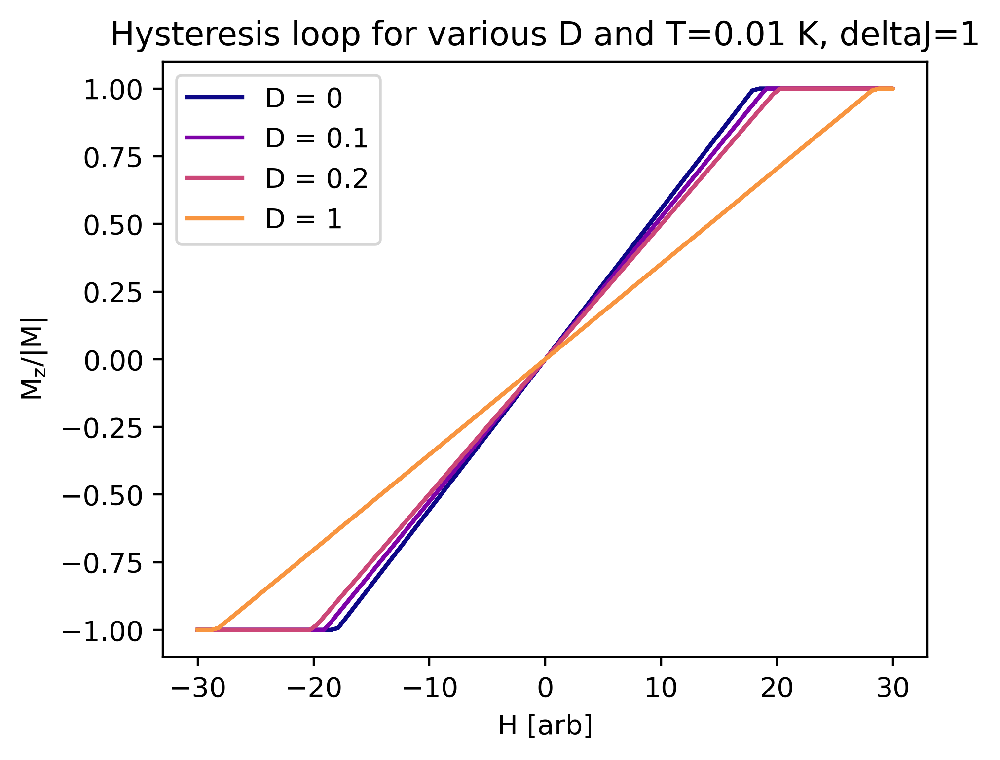

In [ ]:
plot_hyst_by_dm(Ts[0], 1)

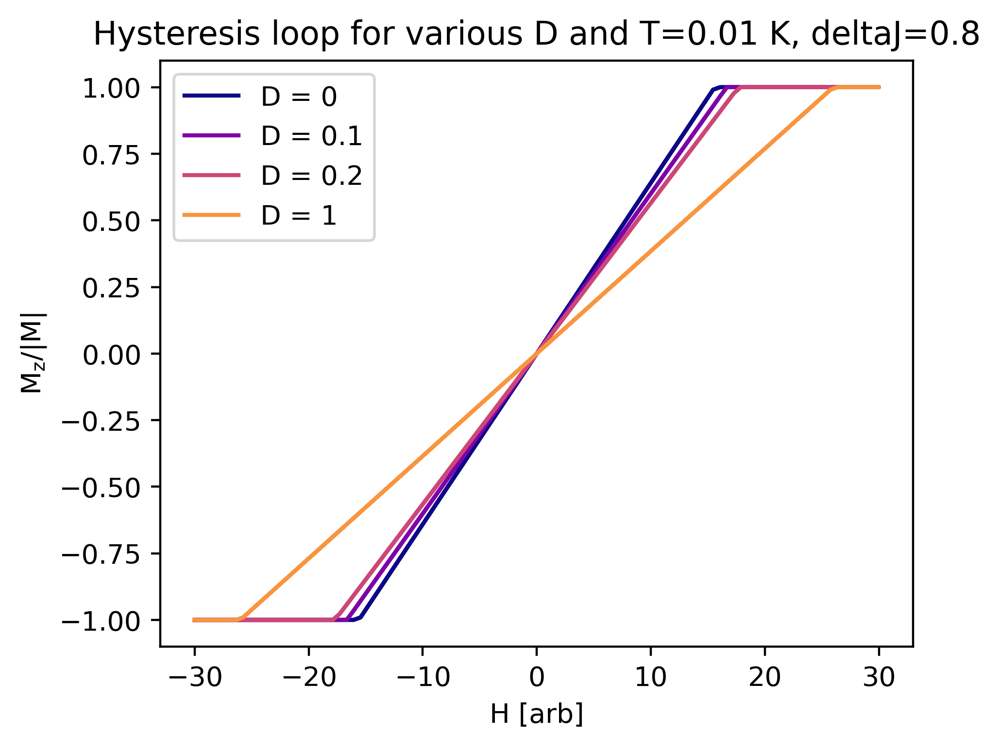

In [ ]:
plot_hyst_by_dm(Ts[0], 0.8)

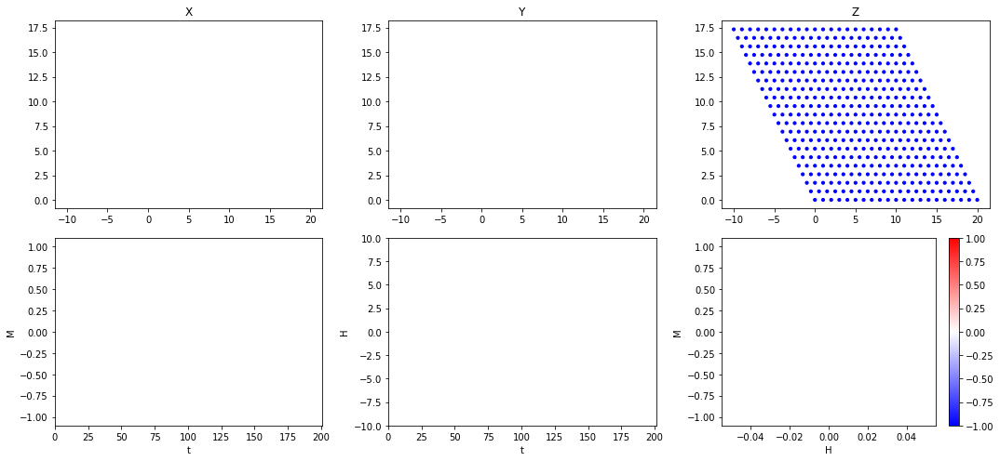

In [7]:
anim = get_anim(Ts[0], 0.1, 0.8)

In [8]:
display.HTML(anim.to_jshtml())


/home/jp/europium/pysd_package/vis.py:246: UserWarning: Attempting to set identical left == right == 0.0 results in singular transformations; automatically expanding.
  ax23.set_xlim(np.array(mhx).min()/mRyToTesla, np.array(mhx).max()/mRyToTesla)


In [30]:
with open("no6/0.01/0.08/1/experiment.out", "rb") as fp:
    exp_outofplane_fm = pickle.load(fp)

Text(0, 0.5, '$M_z$')

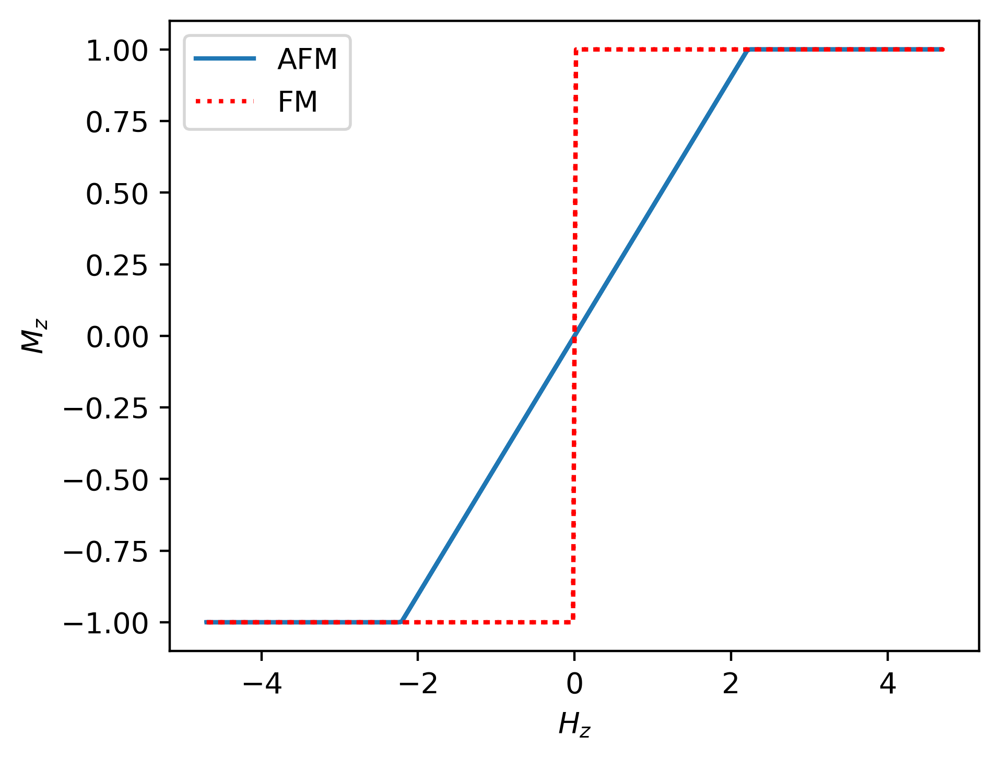

In [ ]:
plt.figure(dpi=400, figsize=(5, 4))
hs = [x.hz for x in exp_outofplane_fm['configs']]
ms = [x.avg_M()[2] for x in exp_outofplane_fm['restartfiles']]
ms_fm = [1 if h >= 0 else -1 for h in hs]
dms = [x.dmfile.interactions[1] for x in exp_outofplane_fm['configs']]
plt.plot(np.array(hs)/2000, ms, label="AFM+FM")
plt.plot(np.array(hs)/2000, ms_fm, label="FM", color="red", linestyle="dotted")
plt.legend()
plt.xlabel(r"$H_z$")
plt.ylabel(r"$M_z$")

In [35]:
dms

[[1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
 [1, 1, 0.5, 0.86603, 0.0, 0, 0, 0.08],
